# IceTop SLC Charge Calibration

Signals in IceCube are *calibrated*. The calibration procedure takes signals expressed in arbitrary hardware units and expresses them in physical units. One of the steps in the calibration process is to subtract a baseline from the signal at every time, and this baseline is usually estimated offline.

However, this is not always that case. Some signals are acquired under relaxed conditions, something we call *soft local coincidences*, or SLC. These SLC signals occur very frequently. As a consequence, the information recorded for each of them has to be summarized. In order to do this, the firmware in the optical module subtracts the baseline to the best of its knowledge, based on prior calibrations. As a result, if the baseline drifts from the time it is calibrated until the time signals are acquiredm the signals are systematically shifted by an unknown amount.

In [1]:
# @hidden_cell
import pandas
import itertools
import cPickle
import matplotlib
matplotlib.rcParams['figure.max_open_warning'] = 100

In [ ]:
h5file = '/Users/javier/Work/slc_calib_2010_2016-tmp.h5'
calib_params = '/Users/javier/Work/slc_calib_parameters_2010_2016-tmp.pcl'

In [2]:
#'/Users/javier/Work/slc_calib_2010_2015.h5'
#'/Users/javier/Work/slc_calib_2010_jan2017.h5'
with tables.File(h5file) as h5file:
    calib = pandas.DataFrame(h5file.root.SLCCalib[:])


#'/Users/javier/Downloads/slc_calib_parameters.pcl'
#'/Users/javier/Work/slc_calib_parameters_v3.pcl'
with open(calib_params) as f:
    calib_params = cPickle.load(f)



In [38]:
def plot(string_ids, om_ids, chip_ids=0, atwd_ids=1):
    if not type(string_ids)==list: string_ids=[string_ids]
    if not type(om_ids)==list: om_ids=[om_ids]
    if not type(chip_ids)==list: chip_ids=[chip_ids]
    if not type(atwd_ids)==list: atwd_ids=[atwd_ids]

    light_colors = ['RoyalBlue', 'pink', 'CadetBlue', 'PeachPuff', 'Violet']
    colors = ['blue', 'red', 'teal', 'orange', 'purple']
    selections = []
    labels = []
    for string_id, om_id, chip_id, atwd_id in itertools.product(string_ids, om_ids, chip_ids, atwd_ids):
        ok = (calib.string==string_id)&(calib.om==om_id)&(calib.chip==chip_id)&(calib.atwd==atwd_id)
        selections.append(ok)
        labels.append('OM(%d,%d) %d.%d'%(string_id, om_id, chip_id, atwd_id))

    All = selections[0]
    for s in selections[1:]:
        All |= s
 
    from icecube import dataclasses
    fig = plt.figure(figsize=(16,3))
    ax1 = plt.subplot(1,2,1)
    for i,ok in enumerate(selections):
        start = [dataclasses.I3Time(float(x)).date_time for x in calib.start[ok]]
        ax1.plot(start, calib.p0[ok],'.', alpha=0.6, color=light_colors[i%len(colors)])
    if All.sum() > 1:
        plt.ylim(ymin=calib.p0[All].median()-5*calib.p0[All].std(), ymax=calib.p0[All].median()+5*calib.p0[All].std())
    plt.title('P0 String {:d} OM {:d} ATWD {:d}'.format(string_id, om_id, atwd_id))
    ax2 = plt.subplot(1,2,2)
    for i,ok in enumerate(selections):
        start = [dataclasses.I3Time(float(x)).date_time for x in calib.start[ok]]
        ax2.plot(start, calib.p1[ok],'.', alpha=0.6, color=light_colors[i%len(colors)])
    plt.ylim(ymin=0.9, ymax=1.25)
    plt.title('P1 String {:d} OM {:d} ATWD {:d}'.format(string_id, om_id, atwd_id))
    plt.legend(labels, loc='best')

    for i, (string_id, om_id, chip_id, atwd_id) in enumerate(itertools.product(string_ids, om_ids, chip_ids, atwd_ids)):
        if not (string_id, om_id, chip_id, atwd_id) in calib_params.keys(): continue
        params = calib_params[(string_id, om_id, chip_id, atwd_id)]
        x = [dataclasses.I3Time(float(x)).date_time for x in params[0]]
        ax1.plot(x, params[1], linewidth=2, color=colors[i%len(colors)])
        ax2.plot(x, params[2], linewidth=2, color=colors[i%len(colors)])

    return fig


# An OK DOM

In the following plot, we have the intercept (P0) and the slope (P1) of the $Q_{HLC}-Q_{SLC}$ conversion. The interpolated smoothed values are shown as thick colored lines. In the first plot, both ATWDs are shown for the same ATWD channel. In the second plot, all ATWD channels are shown for chip 0.

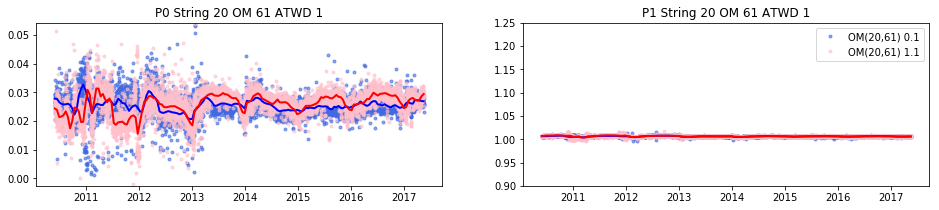

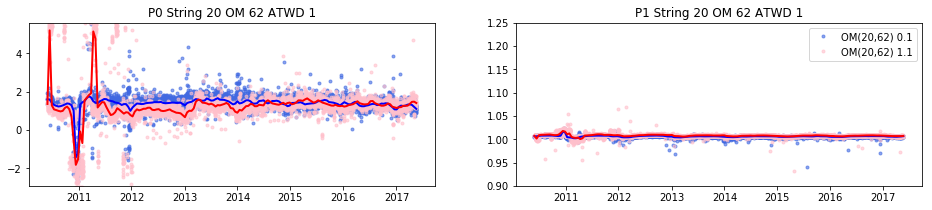

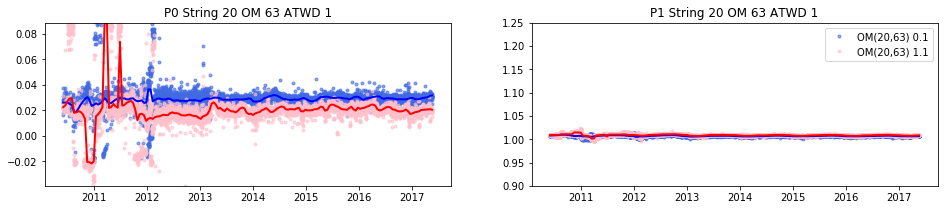

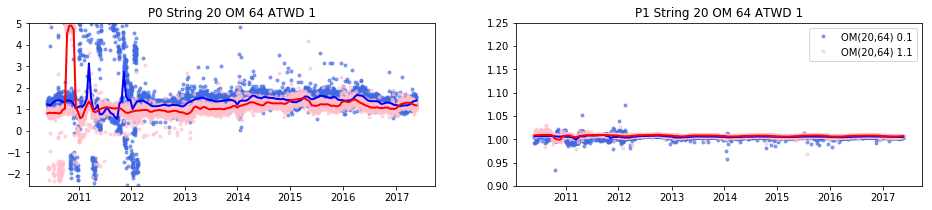

In [4]:
for s, om, gain_id in itertools.product([20],[61,62,63,64], [0]):
    plot(s, om, [0,1], [1]) # string, om, chip, atwd

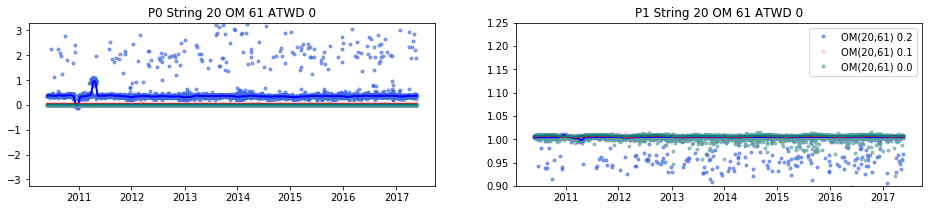

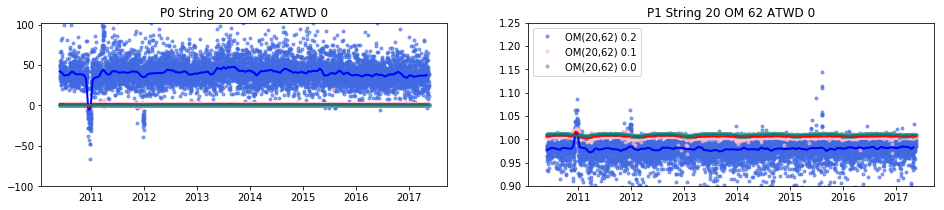

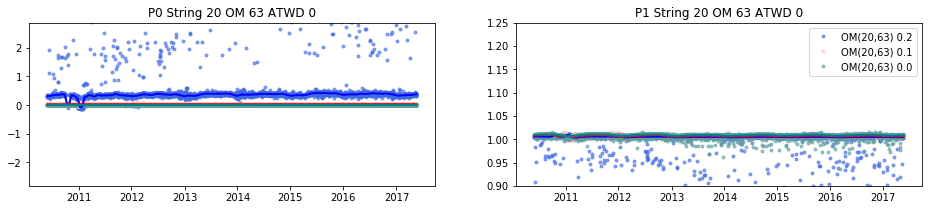

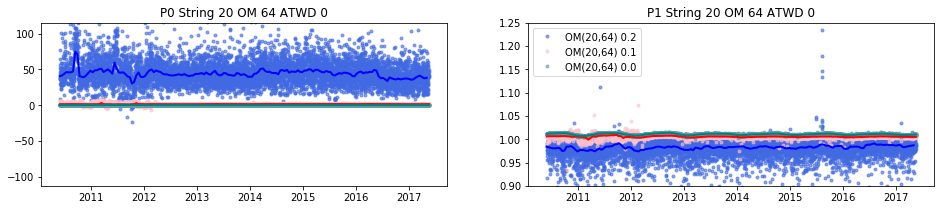

In [5]:
for s, om, gain_id in itertools.product([20],[61,62,63,64], [0]):
    plot(s, om, [0], [2,1,0])

# Droopy DOMs (comparing chips)

/Users/javier/Library/Python/2.7/lib/python/site-packages/pandas/core/computation/expressions.py:180: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  .format(op=op_str, alt_op=unsupported[op_str]))


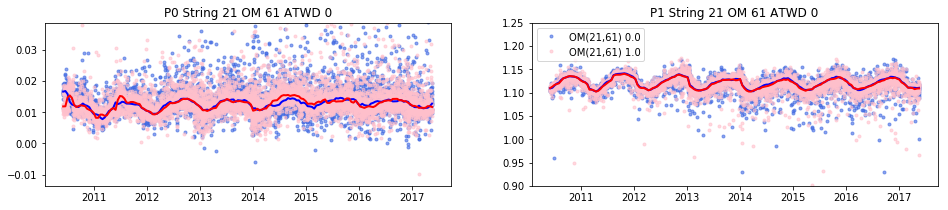

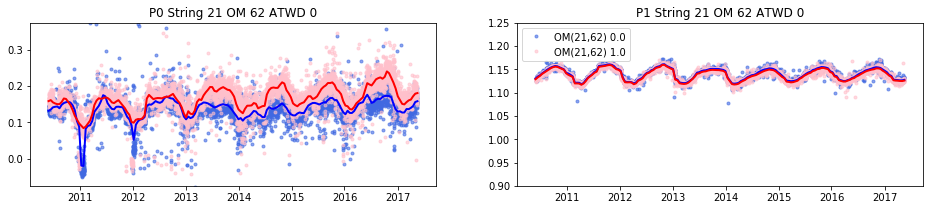

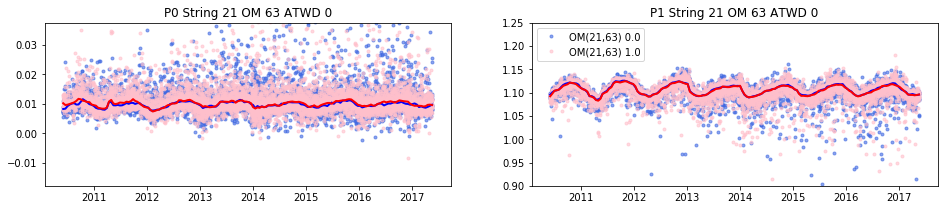

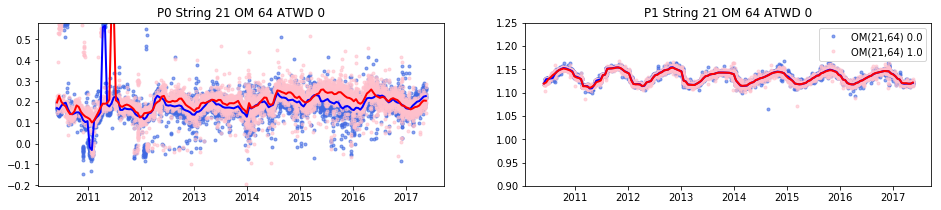

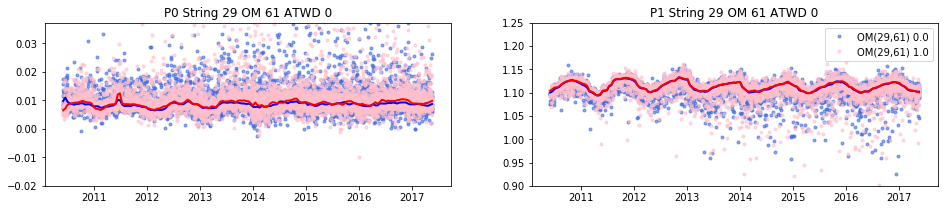

...

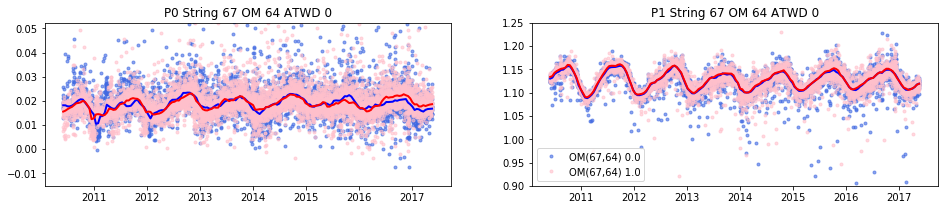

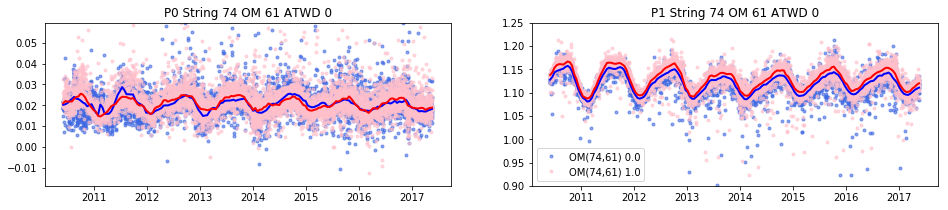

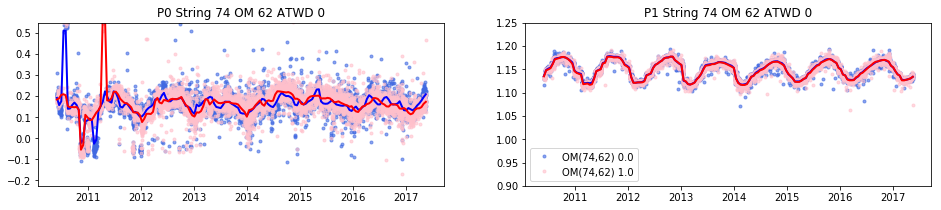

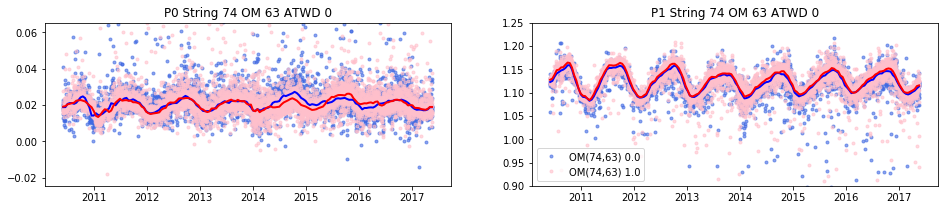

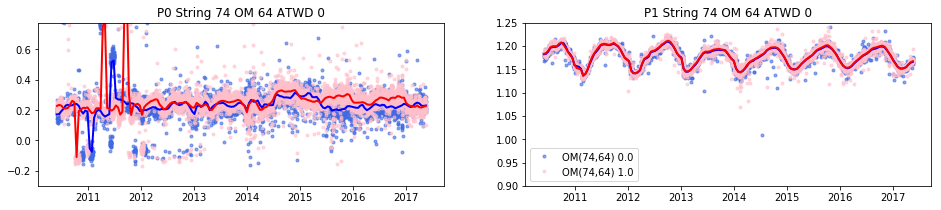

In [37]:
for s, om, gain_id in itertools.product([21, 29, 30, 38, 39, 40, 47, 48, 49, 50, 57, 58, 58, 66, 67, 74],[61,62, 63, 64], [0]):
    plot(s, om, [0,1], 0)

# Droopy DOMs (comparing ATWD channels, chip 0)

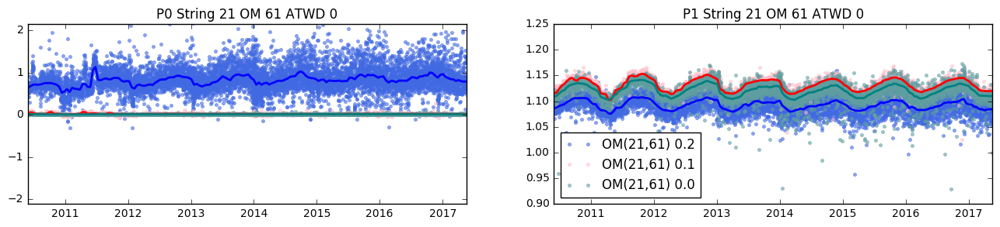

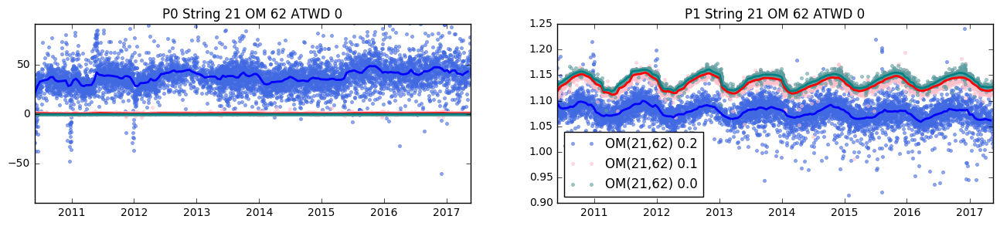

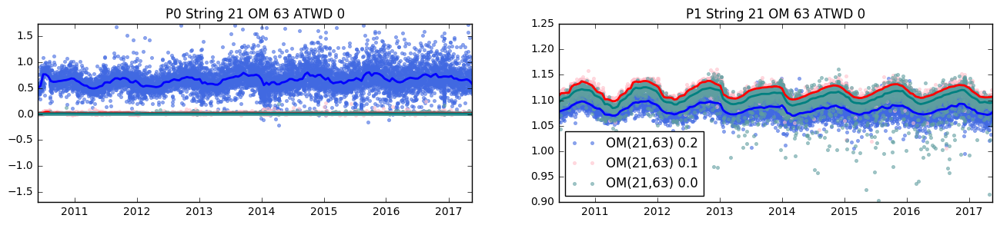

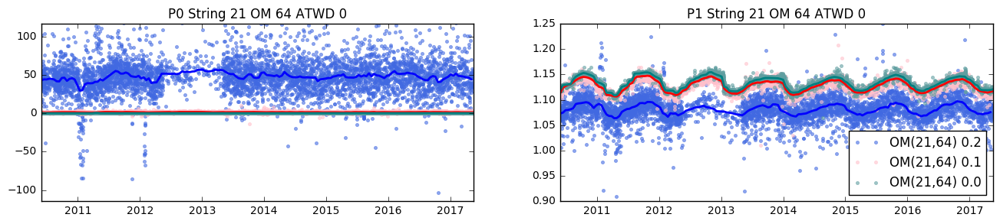

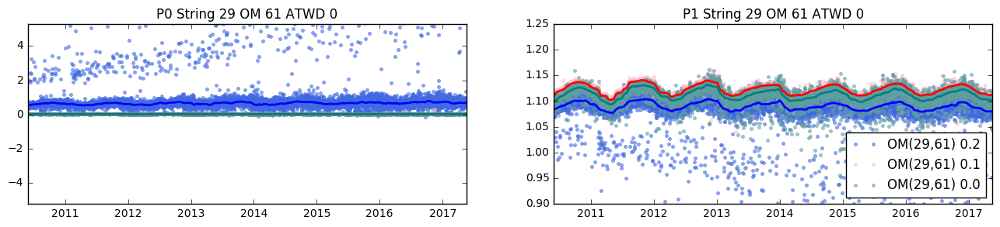

...

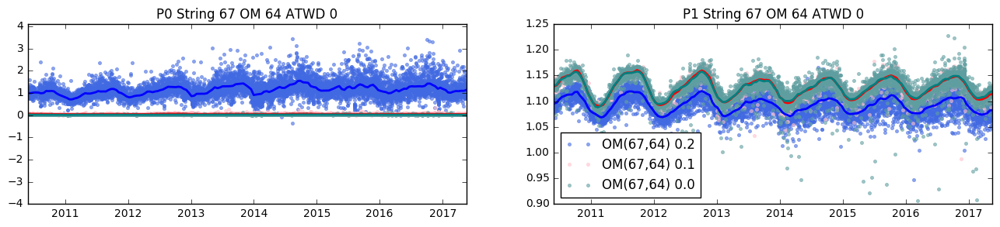

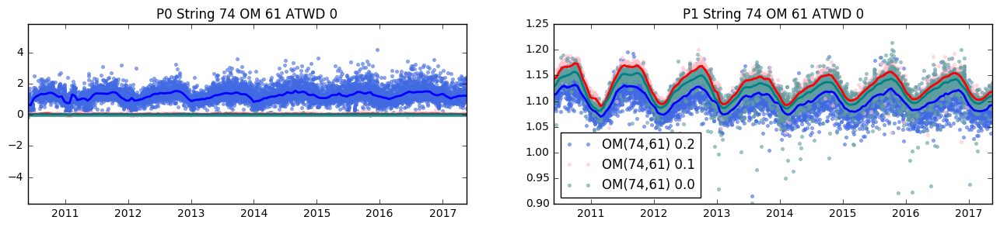

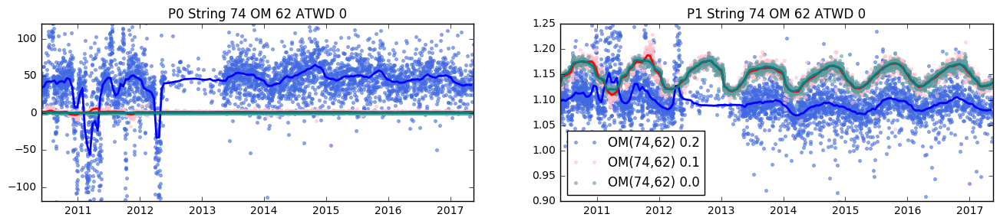

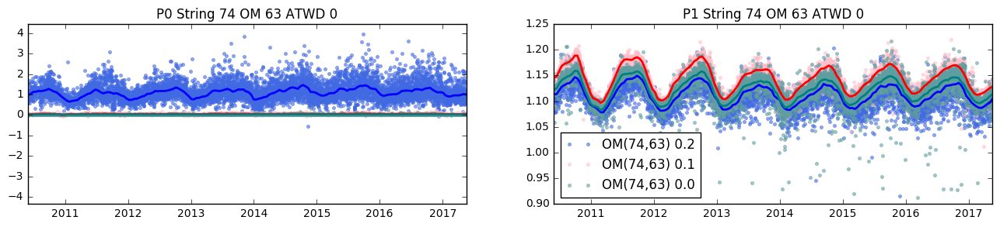

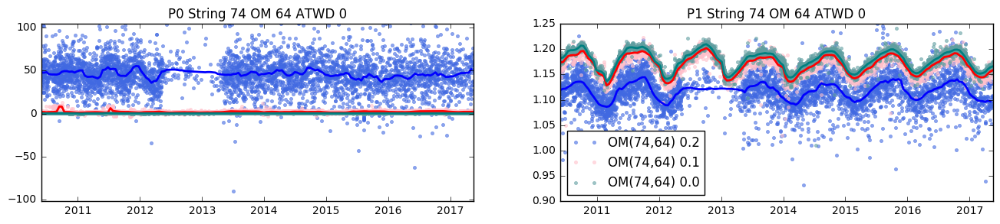

In [14]:
for s, om, gain_id in itertools.product([21, 29, 30, 38, 39, 40, 47, 48, 49, 50, 57, 58, 58, 66, 67, 74],[61,62,63,64], [0]):
    plot(s, om, 0, [2, 1, 0])

# Example Interpolation

(-0.05, 0.05)

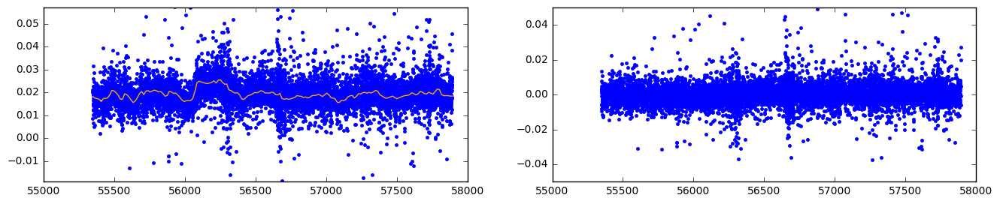

In [15]:
string_id, om_id, chip_id, atwd_id = (29, 61, 0, 1)
ok = (calib.string==string_id)&(calib.om==om_id)&(calib.chip==chip_id)&(calib.atwd==atwd_id)
x = calib.start[ok]
y = calib.p0[ok]
good = calib.good[ok]

series = pandas.Series(y[good==1])

median = series.rolling(100, center=True, min_periods=3).median()
import scipy.interpolate
start = numpy.linspace(min(x), max(x), int(numpy.ceil(abs(max(x) - min(x))/15)))
values_1 = scipy.interpolate.interp1d(x[good==1], median, fill_value='extrapolate')(start)

diff = y - scipy.interpolate.interp1d(start, values_1)(x)

fig = plt.figure(figsize=(16,3))
ax1 = plt.subplot(1,2,1)
plt.plot(x,y,'.')
#plt.plot(x, median, color='r')
plt.plot(start, values_1, color='orange')
plt.ylim(ymin=series.median()-5*series.std(), ymax=series.median()+5*series.std())
#plt.xlim(xmin=55300, xmax=55400)

ax2 = plt.subplot(1,2,2)
plt.plot(x, diff, '.')
plt.ylim(ymin=-0.05, ymax=0.05)
